<a href="https://colab.research.google.com/github/pratik-tan10/Python/blob/main/Notebooks/Deepglobe/deepglobe_land_cover_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd

import os

import keras
import tensorflow as tf
import tensorflow
import keras
import sklearn
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from platform import  python_version
from glob import glob
from keras import backend as K
from tqdm import tqdm
from PIL import Image


In [2]:
!pip install patchify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
from patchify import patchify
from PIL import Image
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda
from tensorflow.keras.optimizers import Adam

import shutil

In [4]:
!pip install -U -q segmentation-models

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 5.0 MB/s eta 0:00:00


In [5]:
keras.utils.generic_utils = keras.utils
import segmentation_models as sm
import warnings
warnings.filterwarnings("ignore")

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

%config Completer.use_jedi = False

sm.set_framework('tf.keras')
sm.framework()

Segmentation Models: using `keras` framework.


'tf.keras'

In [6]:
! pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

In [8]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

In [9]:
! kaggle datasets list -s deepglobe-land-cover-classification-dataset

ref                                                       title                                           size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------  ---------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
balraj98/deepglobe-land-cover-classification-dataset      DeepGlobe Land Cover Classification Dataset      3GB  2020-11-11 02:00:34           4589         87  0.9411765        
quadeer15sh/augmented-forest-segmentation                 Forest Aerial Images for Segmentation          172MB  2021-10-25 07:14:10           1402         46  1.0              
bhaikopath/deepglobe-land-cover-classification-challenge  DeepGlobe Land Cover Classification Challenge     0B  2019-07-02 04:15:12              5          2  0.3125           


In [10]:
! kaggle datasets download -d balraj98/deepglobe-land-cover-classification-dataset


100% 2.73G/2.74G [00:25<00:00, 174MB/s]
100% 2.74G/2.74G [00:25<00:00, 116MB/s]


In [11]:
! unzip -q deepglobe-land-cover-classification-dataset.zip  -d deepglobe-land-cover-classification-dataset

In [12]:
base_dir = './deepglobe-land-cover-classification-dataset'
print(os.listdir(base_dir))
print("Keras version : " + keras.__version__)
print("Tensorflow version : " + tf.__version__)
print("Python version : " + python_version())
print("Sklearn version : " + sklearn.__version__)
print("CV2 version : " + cv2.__version__)
print("Pandas version : " + pd.__version__)


['metadata.csv', 'class_dict.csv', 'test', 'train', 'valid']
Keras version : 2.12.0
Tensorflow version : 2.12.0
Python version : 3.10.11
Sklearn version : 1.2.2
CV2 version : 4.7.0
Pandas version : 1.5.3


In [13]:
filenames = pd.read_csv(os.path.join(base_dir, 'metadata.csv'))
filenames.head()

,image_id,split,sat_image_path,mask_path
0,100694,train,train/100694_sat.jpg,train/100694_mask.png
1,102122,train,train/102122_sat.jpg,train/102122_mask.png
2,10233,train,train/10233_sat.jpg,train/10233_mask.png
3,103665,train,train/103665_sat.jpg,train/103665_mask.png
4,103730,train,train/103730_sat.jpg,train/103730_mask.png


In [14]:
print(filenames['split'].value_counts())

train    803
test     172
valid    171
Name: split, dtype: int64


In [15]:
train_df = filenames[filenames['split']=='train']
train_df['sat_image_path'] = train_df['sat_image_path'].apply(lambda img_pth: os.path.join(base_dir, img_pth))
train_df['mask_path'] = train_df['mask_path'].apply(lambda img_pth: os.path.join(base_dir, img_pth))
train_df.head()

,image_id,split,sat_image_path,mask_path
0,100694,train,./deepglobe-land-cover-classification-dataset/...,./deepglobe-land-cover-classification-dataset/...
1,102122,train,./deepglobe-land-cover-classification-dataset/...,./deepglobe-land-cover-classification-dataset/...
2,10233,train,./deepglobe-land-cover-classification-dataset/...,./deepglobe-land-cover-classification-dataset/...
3,103665,train,./deepglobe-land-cover-classification-dataset/...,./deepglobe-land-cover-classification-dataset/...
4,103730,train,./deepglobe-land-cover-classification-dataset/...,./deepglobe-land-cover-classification-dataset/...


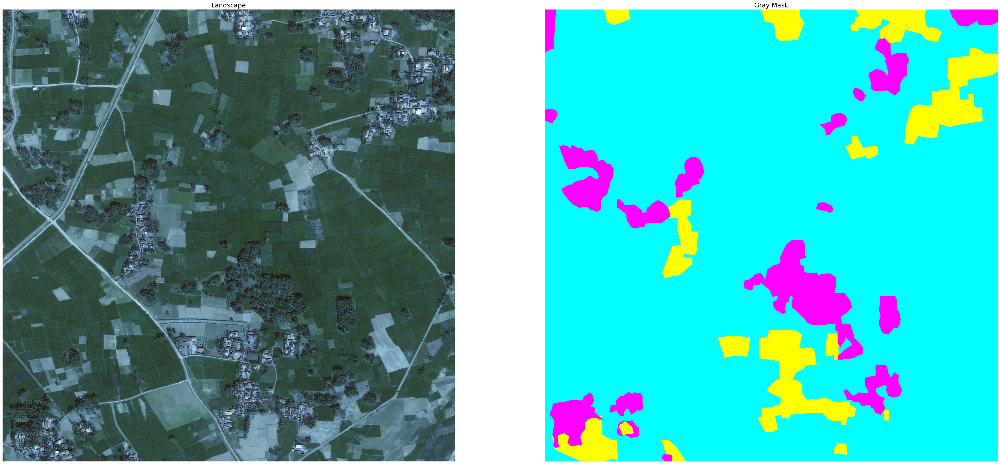

In [16]:
i = np.random.randint(0, len(train_df))
img = cv2.imread(train_df['sat_image_path'].iloc[i])
mask = cv2.imread(train_df['mask_path'].iloc[i])
plt.figure(figsize=(50,50))

plt.subplot(121)
plt.axis('off')
plt.title('Landscape',fontsize=18)
plt.imshow(img)

plt.subplot(122)
plt.axis('off')
plt.title('Gray Mask',fontsize=18 )
plt.imshow(mask)


In [17]:
class_dict = pd.read_csv(os.path.join(base_dir, 'class_dict.csv'))
num_class = len(class_dict)
print(f'Number of classes {num_class}')
class_dict

Number of classes 7


,name,r,g,b
0,urban_land,0,255,255
1,agriculture_land,255,255,0
2,rangeland,255,0,255
3,forest_land,0,255,0
4,water,0,0,255
5,barren_land,255,255,255
6,unknown,0,0,0


In [18]:
if os.path.exists('masks256') :
    shutil.rmtree('masks256')
if os.path.exists('images256') :    
    shutil.rmtree('images256')
    
os.mkdir('images256')
os.mkdir('masks256')

def patches(train_df, patch_size = 256):
    num_of_saved_files = 0
    for img_path, mask_path in tqdm(train_df[['sat_image_path','mask_path']].to_numpy()):
        image = cv2.imread(img_path, 1)
        mask = cv2.imread(mask_path)
        assert image.shape == mask.shape
        SIZE_X = (image.shape[1]//patch_size)*patch_size 
        SIZE_Y = (image.shape[0]//patch_size)*patch_size
        
        image = Image.fromarray(image)
        image = image.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
        image = np.array(image)             

        patches_img = patchify(image, (256, 256, 3), step=256)  #Step=256 for 256 patches means no overlap
        patches_mask = patchify(mask, (256, 256, 3), step=256) 
        
        for i in range(patches_img.shape[0]):
            for j in range(patches_img.shape[1]):
                
                single_patch_mask = patches_mask[i,j,:,:]
                single_patch_mask = single_patch_mask[0]
                
                val, counts = np.unique(single_patch_mask, return_counts=True)
                max_counts = np.max(counts)/counts.sum()
                if max_counts < 0.95:
                    single_patch_img = patches_img[i,j,:,:]
                    single_patch_img = single_patch_img[0]

                    cv2.imwrite(f'images256/{num_of_saved_files}.tif', single_patch_img)
                    cv2.imwrite(f'masks256/{num_of_saved_files}.tif', single_patch_mask) 
                    num_of_saved_files += 1

In [19]:
# Run for creating patches 256x256
patches(train_df)

100%|██████████| 803/803 [10:30<00:00,  1.27it/s]


In [20]:

colors = []
for (r,g,b) in class_dict[['r', 'g', 'b']].to_numpy():
    colors.append([r,g,b])
map_color = {x:v for x,v in zip(range(num_class),colors)}
colors

map_color

{0: [0, 255, 255],
 1: [255, 255, 0],
 2: [255, 0, 255],
 3: [0, 255, 0],
 4: [0, 0, 255],
 5: [255, 255, 255],
 6: [0, 0, 0]}

### Helper functions for preproccesing

In [21]:
# https://stackoverflow.com/questions/43884463/how-to-convert-rgb-image-to-one-hot-encoded-3d-array-based-on-color-using-numpy
# Author : MonsterMax
num_classes =7
def rgb_to_onehot(rgb_arr):
    color_dict= map_color
    num_classes = len(color_dict)
    shape = rgb_arr.shape[:2]+(num_classes,)
    arr = np.zeros( shape, dtype=np.int8 )
    for i, cls_ in enumerate(color_dict):
        arr[:,:,i] = np.all(rgb_arr.reshape( (-1,3) ) == color_dict[i], axis=1).reshape(shape[:2])
    return arr

In [22]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

def preprocess_data_rgb_to_onehot(img, mask, num_class=7):
    masks = np.zeros((mask.shape[0], 256, 256,7))
    for i ,m in enumerate(mask):
        masks[i] =rgb_to_onehot(m)      
        img = scaler.fit_transform(img.reshape(-1, img.shape[-1])).reshape(img.shape)
    return (img,masks)

In [23]:
def onehot_to_rgb(onehot, color_dict= map_color):
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in color_dict.keys():
        output[single_layer==k] = color_dict[k]
    return np.uint8(output)

In [24]:
patched_dir = "."
df_len = len(glob(os.path.join(patched_dir,'images256/*.tif')))
subset = np.empty(df_len, dtype=object)
pd.DataFrame(np.vstack((np.sort(np.array((glob(os.path.join(patched_dir,'images256/*.tif')),glob(os.path.join(patched_dir,'masks256/*.tif'))))), subset)).T, columns = ['img', 'masks','subset'])

,img,masks,subset
0,./images256/0.tif,./masks256/0.tif,None
1,./images256/1.tif,./masks256/1.tif,None
2,./images256/10.tif,./masks256/10.tif,None
3,./images256/100.tif,./masks256/100.tif,None
4,./images256/1000.tif,./masks256/1000.tif,None
...,...,...,...
61226,./images256/9995.tif,./masks256/9995.tif,None
61227,./images256/9996.tif,./masks256/9996.tif,None
61228,./images256/9997.tif,./masks256/9997.tif,None
61229,./images256/9998.tif,./masks256/9998.tif,None


### Preprocess with one-hot encoding

In [25]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

seed=24
batch_size= 32
patched_dir = "."

def data_generator(num_class=7):
    img_data_gen_args = dict(horizontal_flip=True,
                      vertical_flip=True,
                      fill_mode='reflect')
    
    image_datagen = ImageDataGenerator(**img_data_gen_args)
    mask_datagen = ImageDataGenerator(**img_data_gen_args )
    
    validation_split= 0.1

    df_len = len(glob(os.path.join(patched_dir,'images256/*.tif')))
    subset = np.empty(df_len, dtype=object)
    subset[:int((1-validation_split)*df_len)] = 'train'
    subset[int((1-validation_split)*df_len):] = 'valid'
    np.random.shuffle(subset)
    df_filenames = pd.DataFrame(np.vstack((np.sort(np.array((glob(os.path.join(patched_dir,'images256/*.tif')),glob(os.path.join(patched_dir,'masks256/*.tif'))))), subset)).T, columns = ['img', 'masks','subset'])
    df_train = df_filenames[df_filenames.subset  == 'train']
    df_valid = df_filenames[df_filenames.subset  == 'valid']

    image_train_generator = image_datagen.flow_from_dataframe(
        dataframe = df_train,
        train_dir=None,
        x_col="img",
        batch_size= batch_size,
        seed=24,
        class_mode = None)
    
    mask_train_generator = mask_datagen.flow_from_dataframe(
        dataframe = df_train,
        train_dir=None,
        x_col="masks",
        batch_size= batch_size,
        seed=24,
        class_mode = None)
    
    

    mask_valid_generator = image_datagen.flow_from_dataframe(
        dataframe = df_valid,
        train_dir=None,
        x_col="masks",
        batch_size= batch_size,
        seed=24,
        class_mode = None,
        validate_filenames=False)
   

    image_valid_generator = mask_datagen.flow_from_dataframe(
        dataframe = df_valid,
        train_dir=None,
        x_col="img",
        batch_size= batch_size,
        seed=24,
        class_mode = None,
        validate_filenames=False) 
     
    train_generator= zip(image_train_generator,mask_train_generator)
    valid_generator = zip(image_valid_generator, mask_valid_generator)
    return(train_generator,valid_generator)
   
def transform_generator(gen):
    for (img, mask) in gen:
        before = (img.shape,mask.shape)
        img, mask = preprocess_data_rgb_to_onehot(img, mask)
        yield (img, mask)
        
def train_valid_gen(num_class=7):
    train_gen,valid_gen = data_generator(num_class=num_class)
    train_gen = transform_generator(train_gen)
    valid_gen = transform_generator(valid_gen)
    return (train_gen,valid_gen)

In [26]:
t, v = train_valid_gen()

Found 55107 validated image filenames.
Found 55107 validated image filenames.
Found 6124 non-validated image filenames.
Found 6124 non-validated image filenames.


In [27]:
%%time
x, y=next(t)

CPU times: user 5.88 s, sys: 25.9 ms, total: 5.91 s
Wall time: 6.03 s


Preprocess_data takes Wall time: 7.31 s for batch size = 32

In [28]:
def one_hot_encode(label):
    label_values = colors
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1).astype('float')

    return semantic_map

In [29]:
def preprocess_data(imgs, masks):
    return (imgs,one_hot_encode(masks))

### Data Generator without one-hot encoding

In [30]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

seed=24
batch_size= 32

patched_dir = '.'

def data_generator(num_class=7):
    img_data_gen_args = dict(horizontal_flip=True,
                      vertical_flip=True,
                      fill_mode='reflect')
    
    image_datagen = ImageDataGenerator(**img_data_gen_args, rescale=1.0/255.0)
    mask_datagen = ImageDataGenerator(**img_data_gen_args)


    validation_split= 0.2

    df_len = len(glob(os.path.join(patched_dir,'images256/*.tif')))
    subset = np.empty(df_len, dtype=object)
    subset[:int((1-validation_split)*df_len)] = 'train'
    subset[int((1-validation_split)*df_len):] = 'valid'
    np.random.shuffle(subset)
    df_filenames = pd.DataFrame(np.vstack((np.sort(np.array((glob(os.path.join(patched_dir,'images256/*.tif')),glob(os.path.join(patched_dir,'masks256/*.tif'))))), subset)).T, columns = ['img', 'masks','subset'])
    df_train = df_filenames[df_filenames.subset  == 'train']
    df_valid = df_filenames[df_filenames.subset  == 'valid']

    image_train_generator = image_datagen.flow_from_dataframe(
        dataframe = df_train,
        train_dir=None,
        x_col="img",
        batch_size= batch_size,
        seed=24,
        class_mode = None)
    
    mask_train_generator = mask_datagen.flow_from_dataframe(
        dataframe = df_train,
        train_dir=None,
        x_col="masks",
        batch_size= batch_size,
        seed=24,
        class_mode = None)
    

    mask_valid_generator = mask_datagen.flow_from_dataframe(
        dataframe = df_valid,
        train_dir=None,
        x_col="masks",
        batch_size= batch_size,
        seed=24,
        class_mode = None)
   

    image_valid_generator = image_datagen.flow_from_dataframe(
        dataframe = df_valid,
        train_dir=None,
        x_col="img",
        batch_size= batch_size,
        seed=24,
        class_mode = None) 
     
    train_generator= zip(image_train_generator,mask_train_generator)
    valid_generator = zip(image_valid_generator, mask_valid_generator)
    return(train_generator,valid_generator)
   
def transform_generator(gen):
    for (img, mask) in gen:
        img, mask = preprocess_data(img, mask)
        yield (img, mask)
        
def train_valid_gen(num_class=7):
    train_gen,valid_gen = data_generator(num_class=num_class)
    train_gen = transform_generator(train_gen)
    valid_gen = transform_generator(valid_gen)
    return (train_gen,valid_gen)

### Check generator

In [31]:
train_gen, valid_gen = train_valid_gen()

Found 48984 validated image filenames.
Found 48984 validated image filenames.
Found 12247 validated image filenames.
Found 12247 validated image filenames.


one_hot_encode reduces Wall time to 1.24 s

In [32]:
%%time
x, y=next(train_gen)

CPU times: user 630 ms, sys: 39.2 ms, total: 669 ms
Wall time: 740 ms


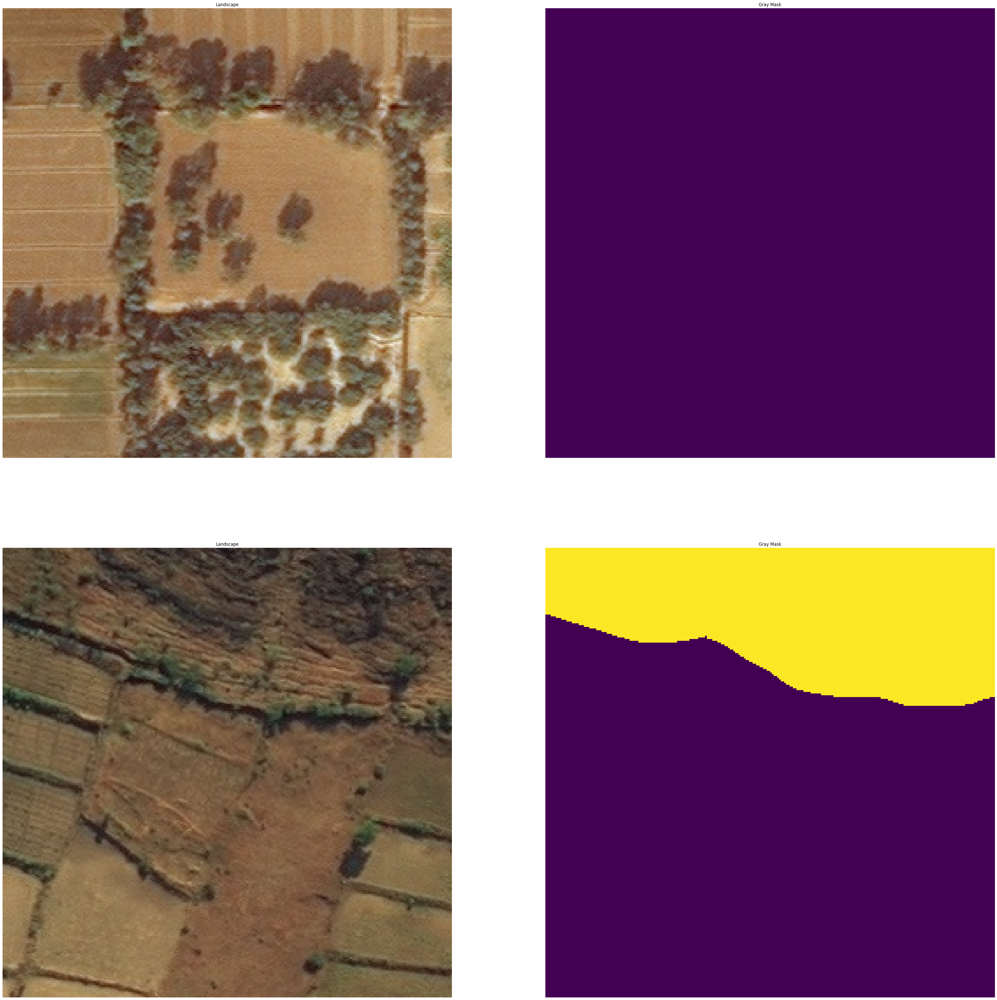

In [33]:
def check_gens(train_gen, valid_gen):
    x, y = next(train_gen)
    i =8
    plt.figure(figsize = (50,50))
    plt.subplot(221)
    plt.axis('off')
    plt.title('Landscape')
    plt.imshow(x[i])

    plt.subplot(222)
    plt.axis('off')
    plt.title('Gray Mask')
    mask =  cv2.imread('./masks256/1.tif')
    plt.imshow(np.argmax((y)[i],axis=2)*64)


    x, y = next(valid_gen)
    plt.subplot(223)
    plt.axis('off')
    plt.title('Landscape')
    plt.imshow(x[i])

    plt.subplot(224)
    plt.axis('off')
    plt.title('Gray Mask')
    mask =  cv2.imread('./masks256/1.tif')
    plt.imshow(np.argmax((y)[i],axis=2)*64)
check_gens(train_gen, valid_gen)

### Callbacks

In [34]:
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard

def callback(name):
    checkpoint = ModelCheckpoint("{}.h5".format(name), monitor='val_iou_score', verbose=1, 
                             save_best_only=True, mode='min', save_weights_only = True)
    reduce = ReduceLROnPlateau(monitor='val_iou_score',
                                   patience=2, 
                                   verbose=1, mode='min', min_delta=0.0001, cooldown=2, min_lr=1e-6)

    early = EarlyStopping(monitor="val_iou_score", 
                      mode="min", 
                      patience=2)
    
    tensorboard = TensorBoard(log_dir="logs/{}".format(name))
    
    callbacks = [checkpoint, early, reduce,tensorboard]
    return callbacks

### U-net Model Architecture

In [35]:

def unet(input_size=(256,256,3)):
    inputs = Input(input_size)
    
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(pool1)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(pool2)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(pool3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(pool4)
    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv5)

    up6 = concatenate([Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv5), conv4], axis=3)
    conv6 = Conv2D(256, (3, 3), activation='relu', padding='same')(up6)
    conv6 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv6)

    up7 = concatenate([Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv6), conv3], axis=3)
    conv7 = Conv2D(128, (3, 3), activation='relu', padding='same')(up7)
    conv7 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv7)

    up8 = concatenate([Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv7), conv2], axis=3)
    conv8 = Conv2D(64, (3, 3), activation='relu', padding='same')(up8)
    conv8 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv8)

    up9 = concatenate([Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(conv8), conv1], axis=3)
    conv9 = Conv2D(32, (3, 3), activation='relu', padding='same')(up9)
    conv9 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv9)

    conv10 = Conv2D(num_class, (1, 1), activation='sigmoid')(conv9)

    return Model(inputs=[inputs], outputs=[conv10])

### Build the model

In [36]:
model = unet()
from tensorflow.keras.metrics import MeanIoU
model.compile(optimizer = Adam(learning_rate = 2e-4), loss=sm.losses.categorical_focal_jaccard_loss, metrics=[sm.metrics.iou_score])

## Fit the model

In [38]:
history = model.fit_generator(train_gen,
                 steps_per_epoch=2692// batch_size,
                 epochs=50, validation_data = valid_gen, validation_steps=300//batch_size, callbacks = callback("luseg"), verbose = 1)

Epoch 1/50
84/84 [==============================] - ETA: 0s - loss: 0.8570 - iou_score: 0.1430
Epoch 1: val_iou_score improved from inf to 0.14300, saving model to luseg.h5
84/84 [==============================] - 98s 1s/step - loss: 0.8570 - iou_score: 0.1430 - val_loss: 0.8570 - val_iou_score: 0.1430 - lr: 1.0000e-05
Epoch 2/50
84/84 [==============================] - ETA: 0s - loss: 0.8570 - iou_score: 0.1430
Epoch 2: val_iou_score improved from 0.14300 to 0.14299, saving model to luseg.h5
84/84 [==============================] - 97s 1s/step - loss: 0.8570 - iou_score: 0.1430 - val_loss: 0.8570 - val_iou_score: 0.1430 - lr: 1.0000e-05
Epoch 3/50
84/84 [==============================] - ETA: 0s - loss: 0.8570 - iou_score: 0.1430
Epoch 3: val_iou_score did not improve from 0.14299

Epoch 3: ReduceLROnPlateau reducing learning rate to 1e-06.
84/84 [==============================] - 97s 1s/step - loss: 0.8570 - iou_score: 0.1430 - val_loss: 0.8569 - val_iou_score: 0.1431 - lr: 1.0000e-0

### Predict

In [43]:
def predict_image(model, img):
    w,h = img.shape[:2]
    w = w // 256 +1
    h = h // 256 +1
    padding_shape = (w*256,h*256 ,3)
    padded_img= np.zeros(padding_shape)
    mask_shape = (w*256,h*256,7)

    padded_img[0:img.shape[0], 0:img.shape[1], :] = img
    padded_img = padded_img/255
    mask_padded = np.zeros(mask_shape)

    for i in range(0,mask_shape[0], 256):
        for j in range(0, mask_shape[1], 256):
            patch = padded_img[i:i+256,j:j+256,:]
            predicted  = model.predict(np.expand_dims(patch,axis=0), verbose = 0)
            mask_padded[i:i+256,j:j+256,:] =predicted 
    return mask_padded[0:img.shape[0], 0:img.shape[1], :]

In [58]:
test_img = cv2.imread('./deepglobe-land-cover-classification-dataset/train/10452_sat.jpg')
prediction = predict_image(model, test_img)
prediction_mask = onehot_to_rgb(prediction)

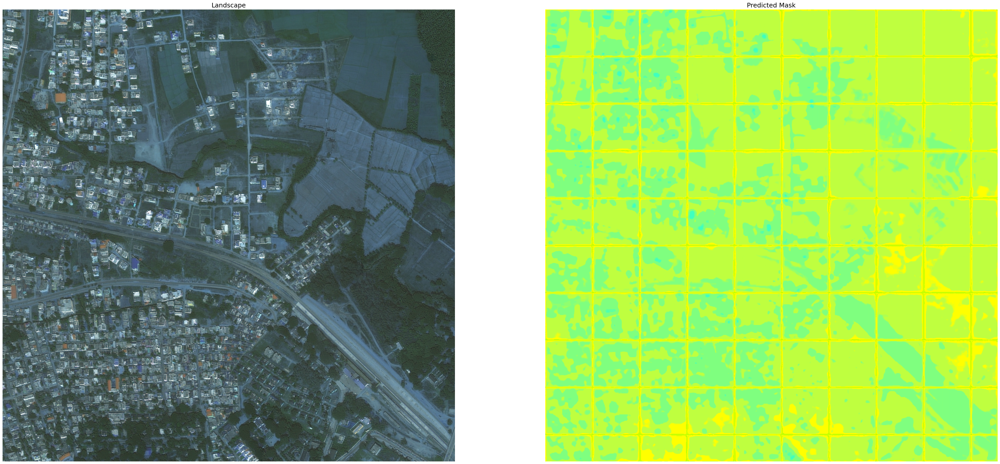

In [59]:

plt.figure(figsize=(50,50))

plt.subplot(121)
plt.axis('off')
plt.title('Landscape',fontsize=18)
plt.imshow(test_img)

plt.subplot(122)
plt.axis('off')
plt.title('Predicted Mask',fontsize=18 )
plt.imshow(prediction_mask)

In [62]:
test_img.shape, prediction_mask.shape

((2448, 2448, 3), (2448, 2448, 3))

### U-net using segmentation models

In [45]:
def u_net_models(backbones):
    
    metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), 'accuracy']
    histories = {}
    
    for backbone in backbones:
        callbacks = callback(backbone)
        
        model = sm.Unet(backbone, encoder_weights='imagenet', 
                input_shape=(256,256,3),
                classes=7, activation='softmax')
        model.compile(optimizer = Adam(learning_rate = 0.0001), loss=sm.losses.categorical_focal_jaccard_loss, metrics=metrics)
        
        train_gen,valid_gen = train_valid_gen(7)
        print('Model : {}'.format(backbone))
        history = model.fit_generator(train_gen,
                steps_per_epoch=2692// batch_size,
                epochs=50, validation_data = valid_gen, validation_steps=300//batch_size, callbacks =callbacks)
        model.save('{}.h5'.format(backbone))
        histories[backbone] = history
    return histories

In [46]:
backbones = ['resnet34', 'inceptionv3', 'vgg16']

In [47]:
histories = u_net_models(backbones)

85521592/85521592 [==============================] - 1s 0us/step


Found 48984 validated image filenames.
Found 48984 validated image filenames.
Found 12247 validated image filenames.
Found 12247 validated image filenames.
Model : resnet34
Epoch 1/50
84/84 [==============================] - ETA: 0s - loss: 0.8105 - iou_score: 0.3449 - f1-score: 0.4127 - accuracy: 0.6161
Epoch 1: val_iou_score improved from inf to 0.14287, saving model to resnet34.h5
84/84 [==============================] - 138s 1s/step - loss: 0.8105 - iou_score: 0.3449 - f1-score: 0.4127 - accuracy: 0.6161 - val_loss: 1.4923 - val_iou_score: 0.1429 - val_f1-score: 0.1555 - val_accuracy: 0.1069 - lr: 0.0010
Epoch 2/50
84/84 [==============================] - ETA: 0s - loss: 0.7100 - iou_score: 0.4560 - f1-score: 0.5388 - accuracy: 0.7226
Epoch 2: val_iou_score did not improve from 0.14287
84/84 [==============================] - 96s 1s/step - loss: 0.7100 - iou_score: 0.4560 - f1-score: 0.5388 - accuracy: 0.7226 - val_loss: 1.0035 - val_iou_score: 0.1434 - val_f1-score: 0.1562 - val_a

Found 48984 validated image filenames.
Found 48984 validated image filenames.
Found 12247 validated image filenames.
Found 12247 validated image filenames.
Model : inceptionv3
Epoch 1/50
84/84 [==============================] - ETA: 0s - loss: 0.7790 - iou_score: 0.3800 - f1-score: 0.4514 - accuracy: 0.6292
Epoch 1: val_iou_score improved from inf to 0.21205, saving model to inceptionv3.h5
84/84 [==============================] - 162s 1s/step - loss: 0.7790 - iou_score: 0.3800 - f1-score: 0.4514 - accuracy: 0.6292 - val_loss: 1.1528 - val_iou_score: 0.2121 - val_f1-score: 0.2365 - val_accuracy: 0.5658 - lr: 0.0010
Epoch 2/50
84/84 [==============================] - ETA: 0s - loss: 0.6786 - iou_score: 0.4779 - f1-score: 0.5598 - accuracy: 0.7264
Epoch 2: val_iou_score improved from 0.21205 to 0.13084, saving model to inceptionv3.h5
84/84 [==============================] - 101s 1s/step - loss: 0.6786 - iou_score: 0.4779 - f1-score: 0.5598 - accuracy: 0.7264 - val_loss: 1.4613 - val_iou_s

Found 48984 validated image filenames.
Found 48984 validated image filenames.
Found 12247 validated image filenames.
Found 12247 validated image filenames.
Model : vgg16
Epoch 1/50
84/84 [==============================] - ETA: 0s - loss: 0.8433 - iou_score: 0.3100 - f1-score: 0.3820 - accuracy: 0.5896
Epoch 1: val_iou_score improved from inf to 0.14337, saving model to vgg16.h5
84/84 [==============================] - 141s 1s/step - loss: 0.8433 - iou_score: 0.3100 - f1-score: 0.3820 - accuracy: 0.5896 - val_loss: 1.3959 - val_iou_score: 0.1434 - val_f1-score: 0.1676 - val_accuracy: 0.0658 - lr: 0.0010
Epoch 2/50
84/84 [==============================] - ETA: 0s - loss: 0.7727 - iou_score: 0.3720 - f1-score: 0.4493 - accuracy: 0.7016
Epoch 2: val_iou_score did not improve from 0.14337
84/84 [==============================] - 107s 1s/step - loss: 0.7727 - iou_score: 0.3720 - f1-score: 0.4493 - accuracy: 0.7016 - val_loss: 0.9899 - val_iou_score: 0.3157 - val_f1-score: 0.3772 - val_accura

### Predict using trained models

In [48]:
models_path = ['resnet34.h5','inceptionv3.h5', 'vgg16.h5']


In [49]:
def predict(img, paths):
    predicted_masks = []
    for path in models_path:
        model = keras.models.load_model(path,
                                        custom_objects={'focal_loss_plus_jaccard_loss': sm.losses.categorical_focal_jaccard_loss,
                                                        'iou_score':sm.metrics.IOUScore, 
                                                        'threshold': 0.5,
                                                        'f1-score':sm.metrics.FScore})

        predicted_masks.append(predict_image(model, img))
    return predicted_masks

In [53]:
img = cv2.imread('./deepglobe-land-cover-classification-dataset/train/10452_sat.jpg')

In [55]:
predicted_masks = predict(img, models_path)

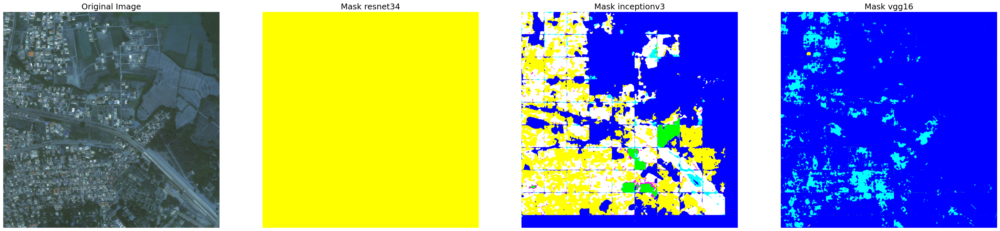

In [56]:
def plot(predicted_masks):
    plt.figure(figsize=(50,50))
    plt.subplots_adjust(bottom=0.3, top=0.7, hspace=0)

    plt.subplot(151)
    plt.title('Original Image' ,fontsize=18)
    plt.axis('off')
    plt.imshow(img)

    plt.subplot(152)
    plt.title('Mask {}'.format(backbones[0]) ,fontsize=18)
    plt.axis('off')
    plt.imshow(onehot_to_rgb(predicted_masks[0]))

    plt.subplot(153)
    plt.title('Mask {}'.format(backbones[1]) ,fontsize=18)
    plt.axis('off')
    plt.imshow(onehot_to_rgb(predicted_masks[1]))

    plt.subplot(154)
    plt.title('Mask {}'.format(backbones[2]) ,fontsize=18)
    plt.axis('off')
    plt.imshow(onehot_to_rgb(predicted_masks[2]))
    plt.savefig('models_masks.jpeg',dpi = 100)
plot(predicted_masks)

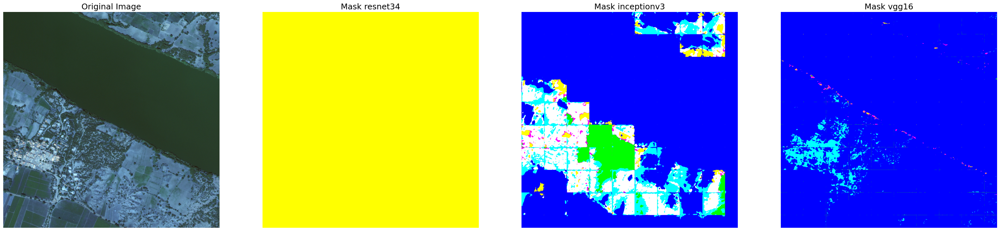

In [63]:
img = cv2.imread('./deepglobe-land-cover-classification-dataset/valid/251219_sat.jpg')
predicted_masks = predict(img, models_path)
plot(predicted_masks)